# SiGra Tutorial
## Outline
1. Installation
2. DataSet settings
3. Import Module
4. Read in Data
5. build graph from gene expression and histology images
6. spatial domain detection using SiGra
7. Identify DEGs
8. Denoising

## 1. Installation  
The source code can be downloaded from github:  
https://github.com/tonyyang1995/scGIT.git

To install Sigra package, you neeed to make sure that your have the following package

torchvision==0.11.1  
matplotlib==2.1.1  
torch==1.6.0  
seaborn==0.10.0  
tqdm==4.47.0  
numpy==1.13.3  
anndata==0.8.0  
pandas==1.4.3  
rpy2==3.5.2  
scanpy==1.9.1  
scipy==1.8.1  
scikit_learn==1.1.1  
torch_geometric==2.0.4  

you can use the the following command to install the requirement package:
```
pip install -r requirements.txt
```
We are using python 3.8.5 for all our experiments

In [1]:
import platform
platform.python_version()

'3.8.5'

## 2. Dataset Setting
### nanostring
The dataset can be download [https://nanostring.com/products/cosmx-spatial-molecular-imager/ffpe-dataset/]
### Merscope
The dataset can be download [https://info.vizgen.com/mouse-liver-access]
### 10x visium
The dataset can be download [https://github.com/LieberInstitute/HumanPilot/]


### folder structure
SiGra
```
├── requirement.txt
├── dataset
│   └── DLPFC
│        └── 151507
│              ├── filtered_feature_bc_matrix.h5
│              ├── metadata.tsv 
│              ├── sampledata.h5ad
│              └── spatial
│                     ├── tissue_positions_list.csv  
│                     ├── full_image.tif  
│                     ├── tissue_hires_image.png  
│                     ├── tissue_lowres_image.png
│   └── nanostring
│        └── Lung9_Rep1_exprMat_file.csv
│        └── matched_annotation_all.csv
│        └── fov1
│              ├── CellComposite_F001.jpg
│              ├── sampledata.h5ad
│        └── fov2
│              ├── CellComposite_F002.jpg
│              ├── sampledata.h5ad
│   └── merscope
│        └── Cell_boundaries
│        └── Cut Images
│        └── sample_data
│        └── processed_data



├── checkpoint
│   └── nanostring_final
│        ├── final.pth
│   └── merscope_all
│        ├── final.pth
│   └── 10x_final
│        └── 151507
│              ├── final.pth
```

### preprocess data
to generate 10x dataset:
1. download the raw data and listed as the above data folder sturcture
2. go the /path/scGIT/src
3. run the code
```
python3 processing_10x.py
python3 processing_nanostring.py
```

## Quick Start

### download our intermeidate results and checkpoints for inference
download the [checkpoints](https://purdue0-my.sharepoint.com/:u:/g/personal/tang385_purdue_edu/EZnAbrQm59dPtGKtSgSUBDABGGW86kh3ur6zZ2e-hVFWXQ?e=MWlkwB) and put them into the above roots.
### inference tutorials
1. for nanostring dataset
The results will be stored in "/path/scGIT/results/nanostring/"
```
python3 train_nano_all.py --test_only 1 --save_path ../checkpoint/nanostring_final/ --pretrain final.pth
```

2. for 10x dataset
The results will be stored in "/path/scGIT/results/10x_final/"
```
python3 -W ignore train_10x.py --test_only 1 --save_path ../checkpoint/10x_final/ --id 151507 --ncluster 7
```
or 
```
bash test_10x.sh
```

## Train from scratch
### training tutorials
1. for nanostring dataset
The hyperparameters were manually selected in individual datasets
```
e.g.
python3 train_nano_all.py --test_only 0 --save_path ../checkpoint/nanostring_train/ --seed 1234 --epochs 900 --lr 1e-3 
```

2. for 10x dataset
```
e.g.
python3 train_10x.py --test_only 0 --save_path ../checkpoint/10x_train/ --seed 1234 --epochs 600 --lr 1e-3 --id 151507 --ncluster 7 --repeat 1
```
or 
```
bash train_10x.sh
```

## 3. Import python modules

In [2]:
import argparse
import pandas as pd
import os
import scanpy as sc
from sklearn.metrics.cluster import adjusted_rand_score
import numpy as np
import cv2
import torchvision.transforms as transforms
from utils import Cal_Spatial_Net, Stats_Spatial_Net, _hungarian_match, seed_everything
from train_transformer import train_nano_fov, test_nano_fov
from sklearn.decomposition import PCA
import torch
import matplotlib.pyplot as plt
import random
from scipy.optimize import linear_sum_assignment

os.environ['PYTHONHASHSEED'] = '1234'
os.environ['CUBLAS_WORKSPACE_CONFIG'] = ':4096:8'

## 4. Read in data (using nanostring dataset for this tutorial)
### 4.1 load parser arguments

In [3]:
parser = argparse.ArgumentParser()
parser.add_argument('--lr', type=float, default=1e-3)
parser.add_argument('--root', type=str, default='../dataset/nanostring')
parser.add_argument('--epochs', type=int, default=2000)
parser.add_argument('--id', type=str, default='fov1')
parser.add_argument('--img_name', type=str, default='F001')
parser.add_argument('--seed', type=int, default=1234)
parser.add_argument('--save_path', type=str, default='../checkpoint/nanostring_all')
parser.add_argument('--ncluster', type=int, default=8)
parser.add_argument('--repeat', type=int, default=1)
parser.add_argument('--use_gray', type=float, default=0)
parser.add_argument('--test_only', type=int, default=1)
parser.add_argument('--pretrain', type=str, default='final.pth')

# in jupyter, we nned to add args=[]
# if you run in scripts, you can run: "opt = parser.parse_args()"
opt = parser.parse_args(args=[])

### 4.2 show an exmaple to load one fov

../dataset/nanostring/fov1/CellComposite_F001.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 25140 edges, 4966 cells.
5.0624 neighbors per cell on average.


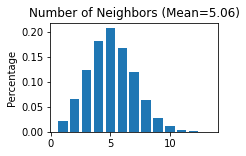

In [4]:
root = opt.root
img_name = 'F001'
id = 'fov1'
adata = sc.read(os.path.join(root, id, 'sampledata.h5ad'))
adata.var_names_make_unique()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

ncluster = len(set(adata.obs['merge_cell_type']))

print(os.path.join(root, id, 'CellComposite_%s.jpg'%(img_name)))
img = cv2.imread(os.path.join(root, id, 'CellComposite_%s.jpg'%(img_name)))
height, width, c = img.shape
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
overlay = cv2.imread(os.path.join(root, id, 'CompartmentLabels_%s.tif'%(img_name)))
overlay = cv2.cvtColor(overlay, cv2.COLOR_BGR2GRAY)
print(overlay.shape)

if opt.use_gray:
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
transform = transforms.ToTensor()
img = transform(img)
overlay = transform(overlay)

patchs = []
w, h = 60, 60
    
for coor in adata.obsm['spatial']:
    x, y = coor
    img_p = img[:, int(y-h):int(y+h), int(x-w): int(x+w)]

    patchs.append(img_p.flatten()) # 4 * h * w
patchs = np.stack(patchs)


df = pd.DataFrame(patchs, index=adata.obs.index)
adata.obsm['imgs'] = df

Cal_Spatial_Net(adata, rad_cutoff=80)
Stats_Spatial_Net(adata)

### 4.3 load all fovs using a function

In [5]:
def gen_adatas(root, id, img_name):
    adata = sc.read(os.path.join(root, id, 'sampledata.h5ad'))
    adata.var_names_make_unique()
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)

    ncluster = len(set(adata.obs['merge_cell_type']))

    print(os.path.join(root, id, 'CellComposite_%s.jpg'%(img_name)))
    img = cv2.imread(os.path.join(root, id, 'CellComposite_%s.jpg'%(img_name)))
    height, width, c = img.shape
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    overlay = cv2.imread(os.path.join(root, id, 'CompartmentLabels_%s.tif'%(img_name)))
    overlay = cv2.cvtColor(overlay, cv2.COLOR_BGR2GRAY)
    print(overlay.shape)

    if opt.use_gray:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    transform = transforms.ToTensor()
    img = transform(img)
    overlay = transform(overlay)

    patchs = []
    w, h = 60, 60
    
    for coor in adata.obsm['spatial']:
        x, y = coor
        img_p = img[:, int(y-h):int(y+h), int(x-w): int(x+w)]

        patchs.append(img_p.flatten()) # 4 * h * w
    patchs = np.stack(patchs)


    df = pd.DataFrame(patchs, index=adata.obs.index)
    adata.obsm['imgs'] = df


    Cal_Spatial_Net(adata, rad_cutoff=80)
    Stats_Spatial_Net(adata)
    return adata

../dataset/nanostring/fov1/CellComposite_F001.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 25140 edges, 4966 cells.
5.0624 neighbors per cell on average.
../dataset/nanostring/fov2/CellComposite_F002.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 20402 edges, 4519 cells.
4.5147 neighbors per cell on average.
../dataset/nanostring/fov3/CellComposite_F003.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 19904 edges, 4497 cells.
4.4261 neighbors per cell on average.
../dataset/nanostring/fov4/CellComposite_F004.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 23804 edges, 4913 cells.
4.8451 neighbors per cell on average.
../dataset/nanostring/fov5/CellComposite_F005.jpg
(3648, 5472)
------Calculating spatial graph...
The graph contains 13998 edges, 3674 cells.
3.8100 neighbors per cell on average.
../dataset/nanostring/fov6/CellComposite_F006.jpg
(3648, 5472)
------Calculating spatial graph...
Th

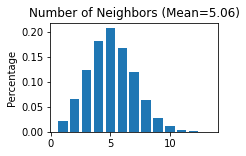

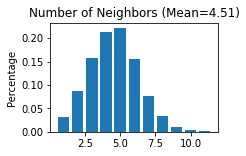

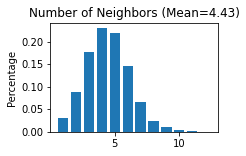

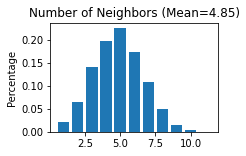

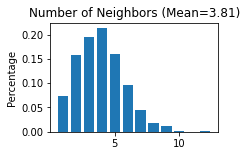

...

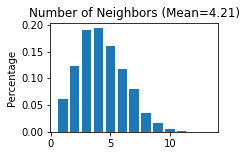

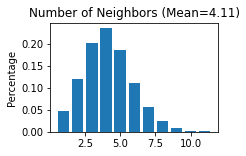

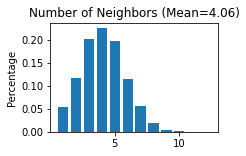

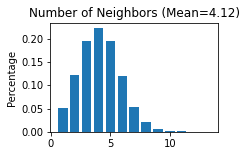

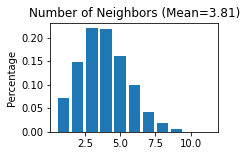

In [6]:
seed_everything(opt.seed)
ids = [
        'fov1', 'fov2', 'fov3', 'fov4', 'fov5',
        'fov6', 'fov7', 'fov8', 'fov9', 'fov10',
        'fov11', 'fov12', 'fov13', 'fov14', 'fov15',
        'fov16', 'fov17', 'fov18', 'fov19', 'fov20'
]
img_names = [
        'F001', 'F002', 'F003', 'F004', 'F005',
        'F006', 'F007', 'F008', 'F009', 'F010',
        'F011', 'F012', 'F013', 'F014', 'F015',
        'F016', 'F017', 'F018', 'F019', 'F020',
]
adatas = list()
for id, name in zip(ids, img_names):
    adata = gen_adatas(opt.root, id, name)
    adatas.append(adata)

### 4.4 train a model 
we skip this step in the tutorial because it took very long time (~10 hours using a 11GB 2080TI to train all 20 fovs),
Instead, you can run the python script from terminal to train the model:
```
python3 train_nano_all.py --test_only 0 --save_path ../checkpoint/nanostring_train/ --seed 1234 --epochs 900 --lr 1e-3 
```
Here we load the trained model to show our results

### 4.5 inference a model
we saved the checkpoints in ../checkpoint/nanostring_all/all

In [7]:
sp = os.path.join(opt.save_path, 'all')
adata = test_nano_fov(opt, adatas, hidden_dims=[512, 30],  n_epochs=opt.epochs, save_loss=True, 
      lr=opt.lr, random_seed=opt.seed, save_path=sp, ncluster=opt.ncluster)

/home/dao2/.local/lib/python3.8/site-packages/anndata-0.8.0rc1-py3.8.egg/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


../checkpoint/nanostring_all/all/final.pth
torch.Size([4966, 30])
torch.Size([4519, 30])
torch.Size([4497, 30])
torch.Size([4913, 30])
torch.Size([3674, 30])
torch.Size([3790, 30])
torch.Size([5103, 30])
torch.Size([4144, 30])
torch.Size([3849, 30])
torch.Size([4118, 30])
torch.Size([4007, 30])
torch.Size([3535, 30])
torch.Size([4707, 30])
torch.Size([3970, 30])
torch.Size([3944, 30])
torch.Size([3908, 30])
torch.Size([4087, 30])
torch.Size([4029, 30])
torch.Size([4121, 30])
torch.Size([3740, 30])


### 4.6 run leiden algorithm
we are using binary search to find the resolutions

In [8]:
sc.pp.neighbors(adata, use_rep='pred')

def res_search(adata_pred, ncluster, seed, iter=200):
    start = 0; end =3
    i = 0
    while(start < end):
        if i >= iter: return res
        i += 1
        res = (start + end) / 2
        print(res)
        seed_everything(seed)
        sc.tl.leiden(adata_pred, random_state=seed, resolution=res)
        count = len(set(adata_pred.obs['leiden']))
        if count == ncluster:
            print('find', res)
            return res
        if count > ncluster:
            end = res
        else:
            start = res
    raise NotImplementedError()

    
seed_everything(opt.seed)
res = res_search(adata, opt.ncluster, opt.seed)

1.5
0.75
0.375
0.5625
0.65625
find 0.65625


In [9]:
seed_everything(opt.seed)
sc.tl.leiden(adata, resolution=res, key_added='leiden', random_state=opt.seed)
obs_df = adata.obs.dropna()
ARI = adjusted_rand_score(obs_df['leiden'], obs_df['merge_cell_type'])
print('ARI: %.2f'%ARI)

ARI: 0.55


### 4.7 match the cell types and saved the processed data

In [10]:
cell_type = list(set(adata.obs['merge_cell_type']))
ground_truth = [i for i in range(len(cell_type))]
gt = np.zeros(adata.obs['merge_cell_type'].shape)
for i in range(len(ground_truth)):
    ct = cell_type[i]
    idx = (adata.obs['merge_cell_type'] == ct)
    gt[idx] = i
gt = gt.astype(np.int32)

pred = adata.obs['leiden'].to_numpy().astype(np.int32)
layers = []
cs = ['' for i in range(pred.shape[0])]
gt_cs = ['' for i in range(pred.shape[0])]
match = _hungarian_match(pred, gt, len(set(pred)), len(set(gt)))
colors = {'lymphocyte': '#E57272FF',
        'Mcell': '#FFCA27FF',
        'tumors': "#A6CEE3",
        'epithelial': "#D3E057FF",
        'mast': '#5B6BBFFF',
        'endothelial': '#26C5D9FF',
        'fibroblast': '#26A599FF',
        'neutrophil': '#B967C7FF'
    }
cs = ['' for i in range(pred.shape[0])]
gt_cs = ['' for i in range(pred.shape[0])]

for ind, j in enumerate(adata.obs['merge_cell_type'].tolist()):
    gt_cs[ind] = colors[j]

for outc, gtc in match:
    idx = (pred == outc)
    for j in range(len(idx)):
        if idx[j]:
            cs[j] = colors[cell_type[gtc]]
adata.obs['cmap'] = cs
adata.obs['gtcmap'] = gt_cs
adata.write('pdata/process_data_%s.h5ad'%opt.pretrain[:-4])


## 5 load processed data and draw spatial
you can also skip the above mentioned steps and try our saved processed data

In [11]:
all_h5ad = sc.read('pdata/process_data_final.h5ad')

/home/dao2/.local/lib/python3.8/site-packages/anndata-0.8.0rc1-py3.8.egg/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [12]:
all_h5ad

AnnData object with n_obs × n_vars = 83621 × 980
    obs: 'cell_type', 'niche', 'cx', 'cy', 'cx_g', 'cy_g', 'merge_cell_type', 'leiden', 'cmap', 'gtcmap'
    uns: 'leiden', 'neighbors'
    obsm: 'gene_pred', 'img_pred', 'imgs', 'pred', 'spatial', 'spatial_global'
    layers: 'recon'
    obsp: 'connectivities', 'distances'

In [13]:
genedf = sc.get.obs_df(
        all_h5ad,
        keys=["leiden", 'cmap', 'gtcmap'])

In [14]:
count = 0
start = 0
aris = []

for id in ids:
    adata = sc.read(os.path.join('../dataset/nanostring', id, 'sampledata.h5ad'))
    start = count
    end = start + adata.shape[0]
    count = count + adata.shape[0]
    
    adata.var_names_make_unique()

    adata.obs['leiden'] = genedf.iloc[start:end]['leiden']
    obs_df = adata.obs.dropna()
    ari = adjusted_rand_score(obs_df['leiden'], obs_df['merge_cell_type'])
    ari = round(ari, 2)

    aris.append(ari)
#     ARI = adjusted_rand_score(obs_df['leiden'], obs_df['merge_cell_type'])
    # adata.obs['cmap'] = genedf.iloc[start:end]['cmap']
    adata.obs['cmap'] = genedf.iloc[start:end]['cmap']
    adata.obs['gtcmap'] = genedf.iloc[start:end]['gtcmap']

    cx, cy = adata.obs['cx'], adata.obs['cy']
    fig = plt.figure(figsize=(9,9))
    plt.axis('off')
    plt.scatter(cx, cy, c=adata.obs['cmap'].tolist(), s=5)
    plt.xlim(0, 5472)
    plt.ylim(3648, 0)
    if not os.path.exists(os.path.join('../results/nano_jupyter', 'pred_fov')):
        os.makedirs(os.path.join('../results/nano_jupyter', 'pred_fov'))
    plt.savefig(os.path.join('../results/nano_jupyter', 'pred_fov', '%s.png'%(id)), bbox_inches='tight')
    plt.savefig(os.path.join('../results/nano_jupyter', 'pred_fov', '%s.pdf'%(id)), bbox_inches='tight')

    fig = plt.figure(figsize=(9,9))
    plt.axis('off')
    plt.scatter(cx, cy, c=adata.obs['gtcmap'].tolist(), s=5)
    # plt.gca().invert_yaxis()
    plt.xlim(0, 5472)
    plt.ylim(3648, 0)
    if not os.path.exists(os.path.join('../results/nano_jupyter', 'gt_fov')):
        os.makedirs(os.path.join('../results/nano_jupyter', 'gt_fov'))
    plt.savefig(os.path.join('../results/nano_jupyter', 'gt_fov', '%s.png'%(id)), bbox_inches='tight')
    plt.savefig(os.path.join('../results/nano_jupyter', 'gt_fov', '%s.pdf'%(id)), bbox_inches='tight')

    plt.close('all')

In [15]:
def merge_fovs(root='pred_fov', save_name='pred.png'):
    n = ['fov1.png', 'fov2.png', 'fov3.png', 'fov4.png',
            'fov5.png', 'fov6.png', 'fov7.png', 'fov8.png',
            'fov9.png', 'fov10.png', 'fov11.png', 'fov12.png',
            'fov13.png', 'fov14.png', 'fov15.png', 'fov16.png',
            'fov17.png', 'fov18.png', 'fov19.png', 'fov20.png',
            ]

    
    im1 = cv2.imread(os.path.join(root, n[0]))
    im2 = cv2.imread(os.path.join(root, n[1]))
    im3 = cv2.imread(os.path.join(root, n[2]))
    im4 = cv2.imread(os.path.join(root, n[3]))
    imrow1 = cv2.hconcat([im1, im2, im3, im4])

    im5 = cv2.imread(os.path.join(root, n[4]))
    im6 = cv2.imread(os.path.join(root, n[5]))
    im7 = cv2.imread(os.path.join(root, n[6]))
    im8 = cv2.imread(os.path.join(root, n[7]))
    imrow2 = cv2.hconcat([im5, im6, im7, im8])

    im9 = cv2.imread(os.path.join(root, n[8]))
    im10 = cv2.imread(os.path.join(root, n[9]))
    im11 = cv2.imread(os.path.join(root, n[10]))
    im12 = cv2.imread(os.path.join(root, n[11]))
    imrow3 = cv2.hconcat([im9, im10, im11, im12])

    im13 = cv2.imread(os.path.join(root, n[12]))
    im14 = cv2.imread(os.path.join(root, n[13]))
    im15 = cv2.imread(os.path.join(root, n[14]))
    im16 = cv2.imread(os.path.join(root, n[15]))
    imrow4 = cv2.hconcat([im13, im14, im15, im16])

    im17 = cv2.imread(os.path.join(root, n[16]))
    im18 = cv2.imread(os.path.join(root, n[17]))
    im19 = cv2.imread(os.path.join(root, n[18]))
    im20 = cv2.imread(os.path.join(root, n[19]))
    imrow5 = cv2.hconcat([im17, im18, im19, im20])

    imall = cv2.vconcat([imrow5, imrow4, imrow3, imrow2, imrow1])
    cv2.imwrite(save_name, imall)

In [16]:
def merge_fovs_pdf(root='pred_fov', save_name='pred.png', title='scGIT'):

    n = [
        ['fov17.png', 'fov18.png', 'fov19.png', 'fov20.png',],
        ['fov13.png', 'fov14.png', 'fov15.png', 'fov16.png',],
        ['fov9.png', 'fov10.png', 'fov11.png', 'fov12.png',],
        ['fov5.png', 'fov6.png', 'fov7.png', 'fov8.png',],
        ['fov1.png', 'fov2.png', 'fov3.png', 'fov4.png',],
    ]

    fig, axs = plt.subplots(5, 4, figsize=(32, 24))
    fig.suptitle(title,fontweight ="bold")

    for i in axs:
        for j in i:
            j.axis('off')

    for i in range(len(n)):
        for j in range(len(n[0])):
            name = n[i][j]
            img = cv2.imread(os.path.join(root, name))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            axs[i,j].imshow(img)

    plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
    plt.savefig(save_name)

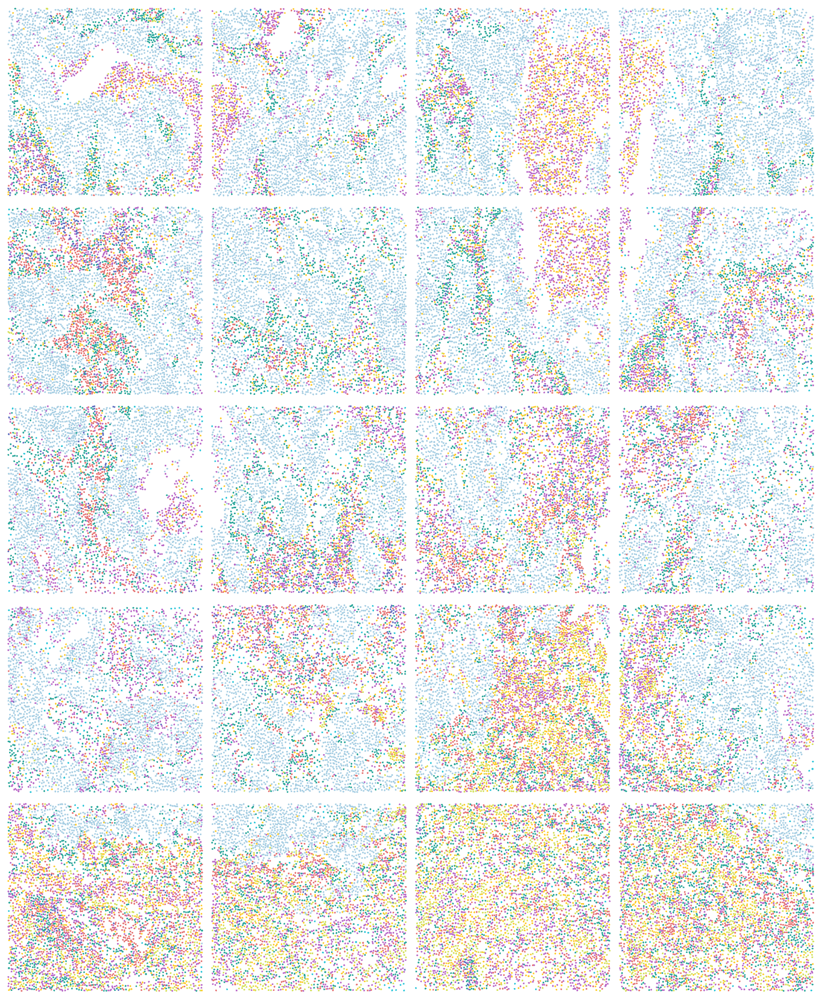

In [17]:
merge_fovs(root='../results/nano_jupyter/pred_fov', save_name='../figures3/pred.png')
merge_fovs(root='../results/nano_jupyter/gt_fov', save_name='../figures3/gt.png')

pred_img = cv2.imread('../figures3/pred.png')
pred_img = cv2.cvtColor(pred_img, cv2.COLOR_BGR2RGB)
figure = plt.figure(figsize=(50, 40))
plt.imshow(pred_img)
plt.axis('off')
plt.savefig('../figures3/pred.pdf')

## 6 denoising

In [18]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
def draw_spatial(gene_name, vmax=1):
    start = 0
    if not os.path.exists('recon/%s/raw'%(gene_name)):
        os.makedirs('recon/%s/raw'%(gene_name))
    if not os.path.exists('recon/%s/recon'%(gene_name)):
        os.makedirs('recon/%s/recon'%(gene_name))
        
    save_path_raw = 'recon/%s/raw'%(gene_name)
    save_path_recon = 'recon/%s/recon'%(gene_name)
    
    for id, iname in zip(ids, img_names):
        adata = sc.read('../dataset/nanostring/%s/sampledata.h5ad'%(id))
        adata.var_names_make_unique()
        sc.pp.normalize_total(adata, target_sum=1e4)
        sc.pp.log1p(adata)    
        cx, cy = adata.obs['cx'], adata.obs['cy']
        img = cv2.imread('../dataset/nanostring/%s/CellComposite_%s.jpg'%(id, iname))
        count = adata.shape[0]
        end = start + count
        adata.layers['recon'] = all_h5ad.layers['recon'][start:end, :]
        
        recon = adata.copy()
        recon.X = adata.layers['recon']
        start += count

        rawv = adata[:, gene_name].X
        reconv = recon[:, gene_name].X
        fig = plt.figure(figsize=(20,20))
        ax = plt.gca()

        ax.axis('off')
        sp = ax.scatter(cx, cy, c=rawv, vmax=vmax)
        ax.invert_yaxis()
        plt.savefig(os.path.join(save_path_raw, '%s.png'%(id)), bbox_inches='tight')
        plt.close('all')
        
        fig = plt.figure(figsize=(20,20))
        ax = plt.gca()

        ax.axis('off')
        sp = ax.scatter(cx, cy, c=reconv, vmax=vmax)
        ax.invert_yaxis()
        plt.savefig(os.path.join(save_path_recon, '%s.png'%(id)), bbox_inches='tight')
        plt.close('all')
#         print('median: ', np.median(rawv), np.median(reconv), 'max: ', rawv.max(), reconv.max())
    fig = plt.figure(figsize=(10,10))
    ax = plt.gca()
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    ax.axis('off')
    fig.colorbar(sp, cax=cax, ax=ax)
    plt.savefig('colorbar.pdf')
    plt.close('all')

    
def merge_fovs_gene(root='pred_fov', save_name='pred.png'):
    n = ['fov1.png', 'fov2.png', 'fov3.png', 'fov4.png',
            'fov5.png', 'fov6.png', 'fov7.png', 'fov8.png',
            'fov9.png', 'fov10.png', 'fov11.png', 'fov12.png',
            'fov13.png', 'fov14.png', 'fov15.png', 'fov16.png',
            'fov17.png', 'fov18.png', 'fov19.png', 'fov20.png',
            ]
    im1 = cv2.imread(os.path.join(root, n[0]))
    im2 = cv2.imread(os.path.join(root, n[1]))
    im3 = cv2.imread(os.path.join(root, n[2]))
    im4 = cv2.imread(os.path.join(root, n[3]))
    imrow1 = cv2.hconcat([im1, im2, im3, im4])

    im5 = cv2.imread(os.path.join(root, n[4]))
    im6 = cv2.imread(os.path.join(root, n[5]))
    im7 = cv2.imread(os.path.join(root, n[6]))
    im8 = cv2.imread(os.path.join(root, n[7]))
    imrow2 = cv2.hconcat([im5, im6, im7, im8])

    im9 = cv2.imread(os.path.join(root, n[8]))
    im10 = cv2.imread(os.path.join(root, n[9]))
    im11 = cv2.imread(os.path.join(root, n[10]))
    im12 = cv2.imread(os.path.join(root, n[11]))
    imrow3 = cv2.hconcat([im9, im10, im11, im12])

    im13 = cv2.imread(os.path.join(root, n[12]))
    im14 = cv2.imread(os.path.join(root, n[13]))
    im15 = cv2.imread(os.path.join(root, n[14]))
    im16 = cv2.imread(os.path.join(root, n[15]))
    imrow4 = cv2.hconcat([im13, im14, im15, im16])

    im17 = cv2.imread(os.path.join(root, n[16]))
    im18 = cv2.imread(os.path.join(root, n[17]))
    im19 = cv2.imread(os.path.join(root, n[18]))
    im20 = cv2.imread(os.path.join(root, n[19]))
    imrow5 = cv2.hconcat([im17, im18, im19, im20])

    imall = cv2.vconcat([imrow5, imrow4, imrow3, imrow2, imrow1])
    cv2.imwrite(save_name, imall)

In [19]:
marker = 'CD68'
draw_spatial(marker, vmax=2)
merge_fovs_gene('recon/%s/raw'%(marker), save_name='recon/raw_%s.png'%(marker))
merge_fovs_gene('recon/%s/recon'%(marker), save_name='recon/recon_%s.png'%(marker))

(-0.5, 4519.5, 5504.5, -0.5)

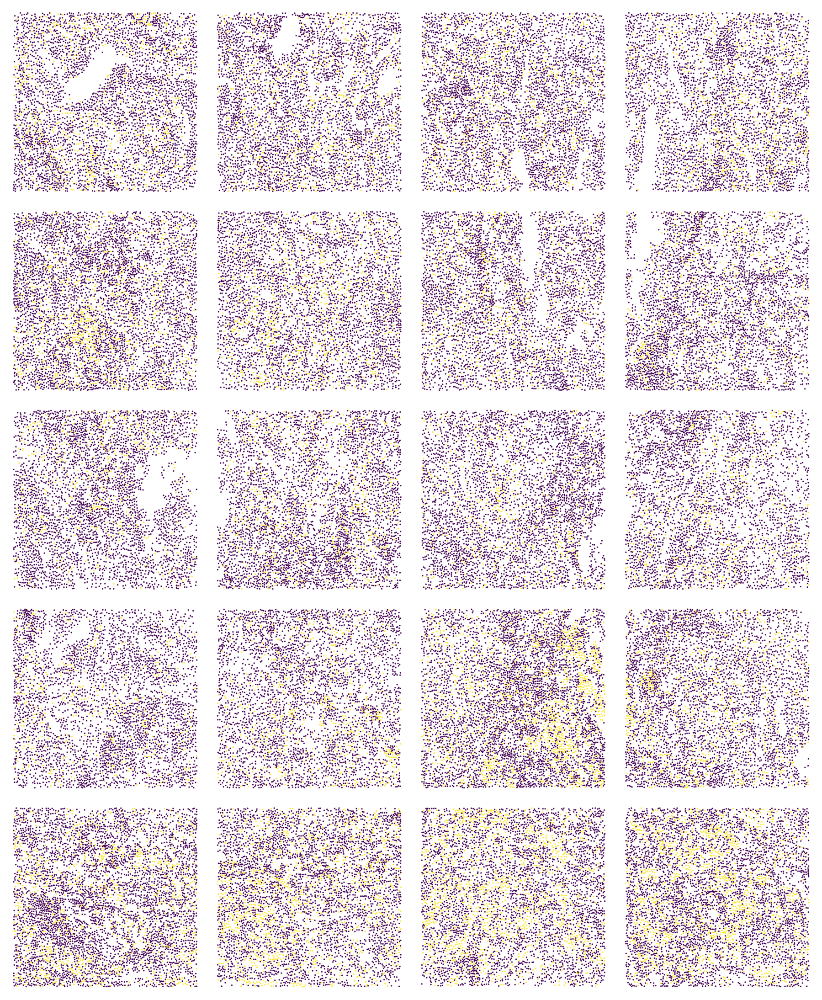

In [20]:
raw_img = cv2.imread('recon/raw_%s.png'%(marker))
raw_img = cv2.cvtColor(raw_img, cv2.COLOR_BGR2RGB)
figure = plt.figure(figsize=(50, 40))
plt.imshow(raw_img)
plt.axis('off')

(-0.5, 4519.5, 5504.5, -0.5)

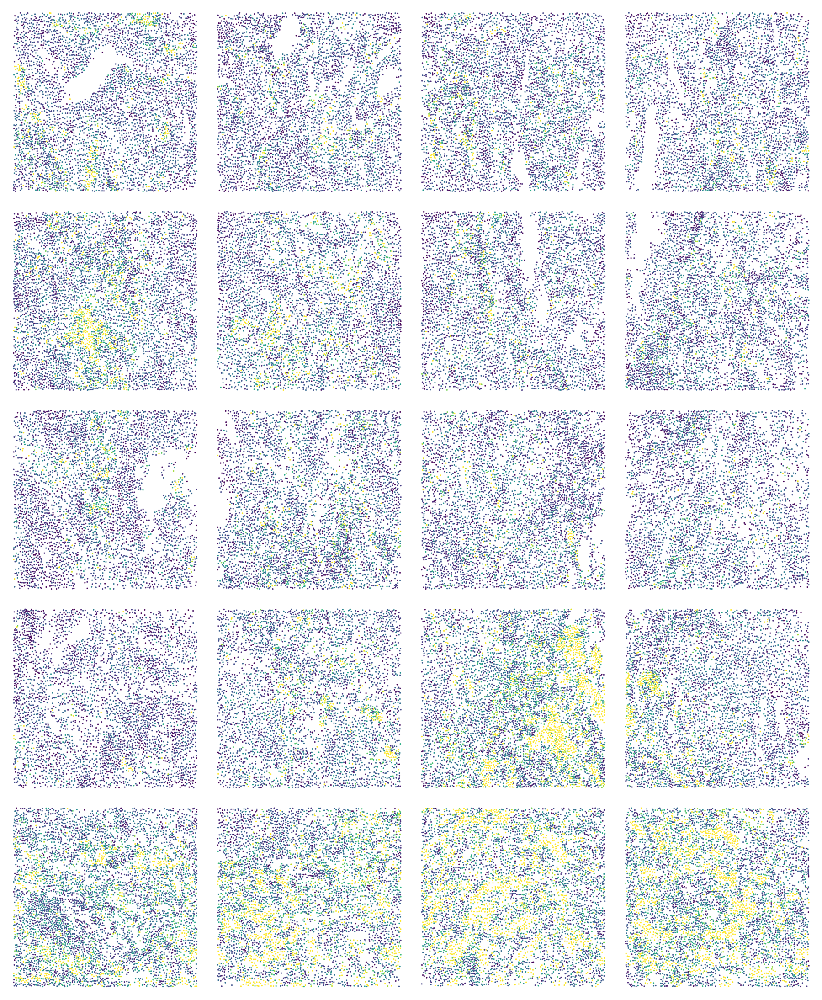

In [21]:
recon_img = cv2.imread('recon/recon_%s.png'%(marker))
recon_img = cv2.cvtColor(recon_img, cv2.COLOR_BGR2RGB)
figure = plt.figure(figsize=(50, 40))
plt.imshow(recon_img)
plt.axis('off')

## 7 UMAP
### 7.1 save csv files for umap

In [22]:
all_h5ad.X.shape

(83621, 980)

In [23]:
import pandas as pd
# change sparse to nparray
raw_data = all_h5ad.X.A
csv = pd.DataFrame(raw_data, index=all_h5ad.obs.index, columns=all_h5ad.var.index)
csv.to_csv('pdata/raw.csv')

In [24]:
recon_data = all_h5ad.layers['recon']
csv = pd.DataFrame(recon_data, index=all_h5ad.obs.index, columns=all_h5ad.var.index)
csv.to_csv('pdata/recon.csv')

### 7.2 process umap without tumor
we saved the csvs of raw and recon data  
and used a Rscript to process them and savedt the umap files  
Here we skipped the rscripts

In [25]:
os.environ['R_HOME'] = '/opt/R/4.0.2/lib/R'
# os.system('R umap.R')